#Preprocessing & Coding

In [ ]:
import numpy as np
import pandas as pd
import nltk
import string

from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

nltk.download()
#nltk.download('punkt')

NLTK Downloader
---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> D

Download which package (l=list; x=cancel)?
  Identifier> l
Packages:
  [ ] abc................. Australian Broadcasting Commission 2006
  [ ] alpino.............. Alpino Dutch Treebank
  [ ] averaged_perceptron_tagger Averaged Perceptron Tagger
  [ ] averaged_perceptron_tagger_eng Averaged Perceptron Tagger (JSON)
  [ ] averaged_perceptron_tagger_ru Averaged Perceptron Tagger (Russian)
  [ ] averaged_perceptron_tagger_rus Averaged Perceptron Tagger (Russian)
  [ ] basque_grammars..... Grammars for Basque
  [ ] bcp47............... BCP-47 Language Tags
  [ ] biocreative_ppi..... BioCreAtIvE (Critical Assessment of Information
                           Extraction Systems in Biology)
  [ ] bllip_wsj_no_aux.... BLLIP Parser: WSJ Model
  [ 

True

In [ ]:
df = pd.read_csv('WELFake_Dataset.csv')

In [ ]:
df.head()

,Unnamed: 0,title,text,label
0,0,LAW ENFORCEMENT ON HIGH ALERT Following Threat...,No comment is expected from Barack Obama Membe...,1
1,1,NaN,Did they post their votes for Hillary already?,1
2,2,UNBELIEVABLE! OBAMA’S ATTORNEY GENERAL SAYS MO...,"Now, most of the demonstrators gathered last ...",1
3,3,"Bobby Jindal, raised Hindu, uses story of Chri...",A dozen politically active pastors came here f...,0
4,4,SATAN 2: Russia unvelis an image of its terrif...,"The RS-28 Sarmat missile, dubbed Satan 2, will...",1


Visualizations

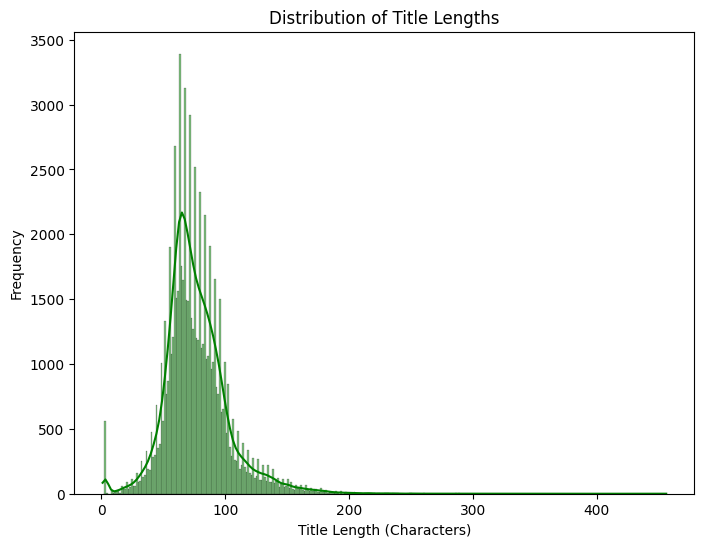

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns # Import seaborn for histplot

df['title_length'] = df['title'].astype(str).apply(len)

plt.figure(figsize=(8, 6))
sns.histplot(df['title_length'], kde=True, color='green')
plt.title('Distribution of Title Lengths')
plt.xlabel('Title Length (Characters)')
plt.ylabel('Frequency')
plt.show()

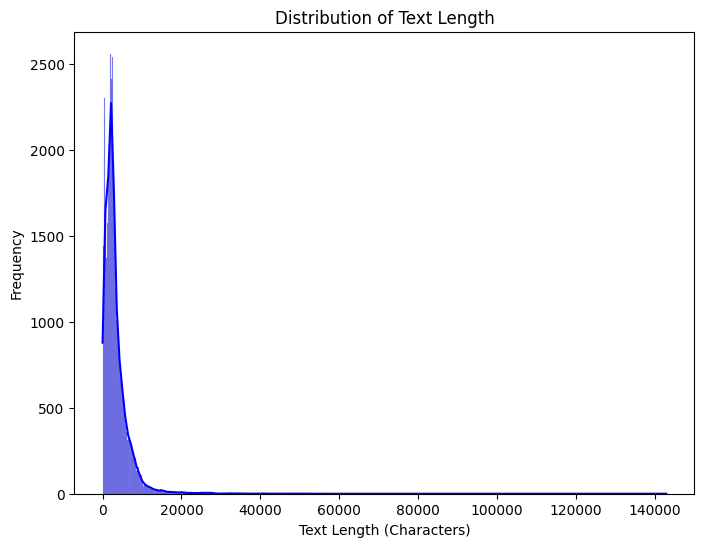

In [ ]:
df['text_length'] = df['text'].astype(str).apply(len)
plt.figure(figsize=(8, 6))
sns.histplot(df['text_length'], kde=True, color='blue')
plt.title('Distribution of Text Length')
plt.xlabel('Text Length (Characters)')
plt.ylabel('Frequency')
plt.show()


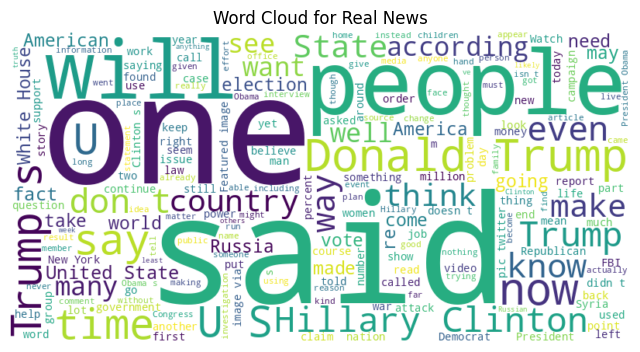

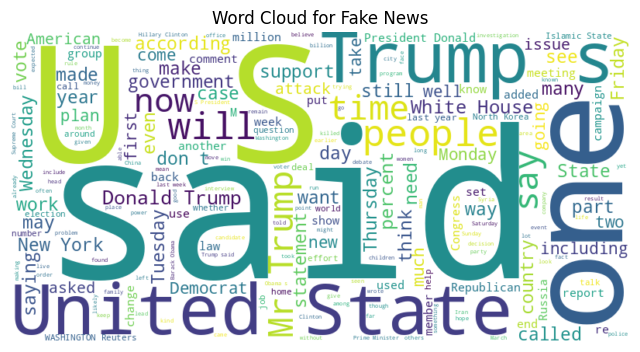

In [ ]:
from wordcloud import WordCloud

# Concatenate text for fake and real news separately
real_news = " ".join(df[df['label'] == 1]['text'].astype(str)) #astype(str) casts each element to string type
fake_news = " ".join(df[df['label'] == 0]['text'].astype(str)) #astype(str) casts each element to string type

# Generate WordCloud for Real News
wordcloud_real = WordCloud(width=800, height=400, background_color='white').generate(real_news)
plt.figure(figsize=(8, 6))
plt.imshow(wordcloud_real, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Real News')
plt.show()

# Generate WordCloud for Fake News
wordcloud_fake = WordCloud(width=800, height=400, background_color='white').generate(fake_news)
plt.figure(figsize=(8, 6))
plt.imshow(wordcloud_fake, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Fake News')
plt.show()

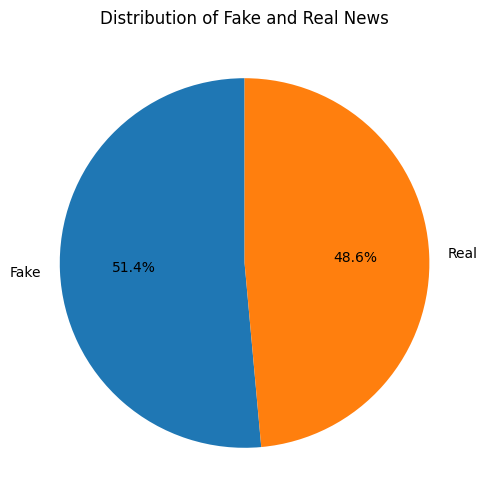

In [ ]:
label_counts = df['label'].value_counts()
plt.figure(figsize=(6, 6))
plt.pie(label_counts, labels=['Fake', 'Real'], autopct='%1.1f%%', startangle=90)
plt.title('Distribution of Fake and Real News')
plt.show()


Preprocessing

In [ ]:
df = df.dropna(subset=['title', 'text']).reset_index(drop=True) # Dropped missing values here... like 'NaN'
df.drop('Unnamed: 0', axis=1, inplace=True) #Remove 'Unnamed' Column
df.drop('title', axis=1, inplace=True) #Remove 'title' column
df.head()

,text,label,title_length,text_length
0,No comment is expected from Barack Obama Membe...,1,130,5049
1,"Now, most of the demonstrators gathered last ...",1,137,216
2,A dozen politically active pastors came here f...,0,105,8010
3,"The RS-28 Sarmat missile, dubbed Satan 2, will...",1,95,1916
4,All we can say on this one is it s about time ...,1,78,1530


In [ ]:
df.shape

(71537, 4)

In [ ]:
from sklearn.preprocessing import LabelEncoder

enc = LabelEncoder()
labelz = enc.fit_transform(df['label'])
print(labelz[:10])
print(df['label'][:10])

[1 1 0 1 1 1 1 1 1 1]
0    1
1    1
2    0
3    1
4    1
5    1
6    1
7    1
8    1
9    1
Name: label, dtype: int64


In [ ]:
#change the text column datatype to string
df = df.astype({'text':'string'})
#get the review text for preprocessing
textz = df['text']
textz[:5]

,text
0,No comment is expected from Barack Obama Membe...
1,"Now, most of the demonstrators gathered last ..."
2,A dozen politically active pastors came here f...
3,"The RS-28 Sarmat missile, dubbed Satan 2, will..."
4,All we can say on this one is it s about time ...


In [ ]:
import nltk
nltk.download('punkt_tab')

textz1 = []

for df in textz:
    #print(sentence)
    #remove punctuation
    df = df.translate(str.maketrans('', '', string.punctuation))
    # remove digits/numbers
    df = df.translate(str.maketrans('', '', string.digits))
    #change to lowercase
    df = df.lower()
    # Tokenize text
    tokens = word_tokenize(df)
    #print(sentence)
    textz1.append(df)


textz1[:5]

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


['no comment is expected from barack obama members of the fyf or fukyoflag and blacklivesmatter movements called for the lynching and hanging of white people and cops they encouraged others on a radio show tuesday night to  turn the tide  and kill white people and cops to send a message about the killing of black people in americaone of the fyoflag organizers is called  sunshine  she has a radio blog show hosted from texas called  sunshine s fing opinion radio show a snapshot of her fyf lolatwhitefear twitter page at  pm shows that she was urging supporters to  call now fyf tonight we continue to dismantle the illusion of white below is a snapshot twitter radio call invite   fyfthe radio show aired at  pm eastern standard timeduring the show callers clearly call for  lynching  and  killing  of white peoplea  minute clip from the radio show can be heard here it was provided to breitbart texas by someone who would like to be referred to as  hannibal  he has already received death threats

In [ ]:
#Convert to Pandas Series
textz1 = pd.Series(textz1)
#textz1[:5]

In [ ]:
import nltk
nltk.download('stopwords')

#remove stop words
#Setting English stopwords
stop_words = set(stopwords.words('english'))

textz1 = textz1.apply(lambda x: ' '.join(term for term in x.split() if term not in stop_words))
textz1[:5]

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


,0
0,comment expected barack obama members fyf fuky...
1,demonstrators gathered last night exercising c...
2,dozen politically active pastors came private ...
3,rs sarmat missile dubbed satan replace ss flie...
4,say one time someone sued southern poverty law...


In [ ]:
#apply stemming
ps = nltk.PorterStemmer()

textz1 = textz1.apply(lambda x: ' '.join(ps.stem(term) for term in x.split()))
textz1[:5]

,0
0,comment expect barack obama member fyf fukyofl...
1,demonstr gather last night exercis constitut p...
2,dozen polit activ pastor came privat dinner fr...
3,rs sarmat missil dub satan replac ss fli mile ...
4,say one time someon su southern poverti law ce...


Pos Tagging

In [ ]:
import nltk

# Download the 'wordnet' dataset
nltk.download('wordnet')

# Download the 'averaged_perceptron_tagger' resource
# Corrected download command for the resource
nltk.download('averaged_perceptron_tagger_eng')

#apply lemmatising with POS tags
from nltk.stem import WordNetLemmatizer

# Init the Wordnet Lemmatizer
lemmatizer = WordNetLemmatizer()

from nltk.corpus import wordnet

def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}

    return tag_dict.get(tag, wordnet.NOUN)

# Init the Wordnet Lemmatizer
lemmatizer = WordNetLemmatizer()
textz3 = textz1.apply(lambda x: ' '.join([lemmatizer.lemmatize(w, get_wordnet_pos(w)) for w in nltk.word_tokenize(x)]))
textz3[:50]

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger_eng.zip.


,0
0,comment expect barack obama member fyf fukyofl...
1,demonstr gather last night exercis constitut p...
2,dozen polit activ pastor come privat dinner fr...
3,r sarmat missil dub satan replac s fli mile km...
4,say one time someon su southern poverti law ce...
5,dr ben carson tell stori happen spoke obama
6,
7,owner ringl bar locat south white sulphur spri...
8,file – sept file photo marker welcom commut cu...
9,punchabl altright nazi internet get thorough b...


In [ ]:
df1 = list(zip(textz3, labelz))
df1[:3]

[('comment expect barack obama member fyf fukyoflag blacklivesmatt movement call lynch hang white peopl cop encourag other radio show tuesday night turn tide kill white peopl cop send messag kill black peopl americaon fyoflag organ call sunshin radio blog show host texa call sunshin fing opinion radio show snapshot fyf lolatwhitefear twitter page pm show urg support call fyf tonight continu dismantl illus white snapshot twitter radio call invit fyfth radio show air pm eastern standard timedur show caller clearli call lynch kill white peoplea minut clip radio show heard provid breitbart texa someon would like refer hannib alreadi receiv death threat result interrupt fyf confer callsan unidentifi black man say mother fker start fing like u bunch nier takin one u roll say caus alreadi roll gang anyway six seven black mother fcker see white person lynch as let turn tabl conspir cop start lose peopl state emerg specul one two thing would happen bigass r war nier go start backin alreadi get 

In [ ]:
dfp = pd.DataFrame (df1, columns = ['text', 'label'])
dfp

,text,label
0,comment expect barack obama member fyf fukyofl...,1
1,demonstr gather last night exercis constitut p...,1
2,dozen polit activ pastor come privat dinner fr...,0
3,r sarmat missil dub satan replac s fli mile km...,1
4,say one time someon su southern poverti law ce...,1
...,...,...
71532,washington reuter hacker believ work russian g...,0
71533,know fantasyland republican never question cit...,1
71534,migrant refus leav train refuge camp hungari t...,0
71535,mexico citi reuter donald trump ’ comb style b...,0


In [ ]:
dfp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71537 entries, 0 to 71536
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   text    71537 non-null  object
 1   label   71537 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 1.1+ MB


In [ ]:
#Shuffling the data to prevent any influence on the perfomance
dfp1 = dfp.sample(frac=1, random_state=1).reset_index()
dfp1.head()

,index,text,label
0,6882,friday ’ broadcast “ pb newshour ” new york ti...,0
1,62919,group saint loui univers basebal player punish...,1
2,53149,monday leagu confer fbi director jame comey sa...,0
3,8116,donald trump want u believ sympath neonazi ku ...,1
4,57957,new york reuter u justic depart issu new guide...,0


In [ ]:
# drop the old index column
dfp1  = dfp1.drop(['index'], axis=1)
dfp1.head()

,text,label
0,friday ’ broadcast “ pb newshour ” new york ti...,0
1,group saint loui univers basebal player punish...,1
2,monday leagu confer fbi director jame comey sa...,0
3,donald trump want u believ sympath neonazi ku ...,1
4,new york reuter u justic depart issu new guide...,0


In [ ]:
# split the dataset

from sklearn.model_selection import train_test_split

# split the data into training and testing sets (80% train, 20% test)
train_df, test_df, train_label, test_label = train_test_split(
    dfp1.text, dfp1.label, test_size=0.2, random_state=42
)

print(train_df.shape, train_label.shape)
print(test_df.shape, test_label.shape)

(57229,) (57229,)
(14308,) (14308,)


In [ ]:
train_df[0]

'friday ’ broadcast “ pb newshour ” new york time columnist david brook argu especi israel russia donald trump “ side foreign leader u presid ” brook say “ what ’ sort remark especi israel russia case you ’ v get u citizen donald trump side foreign leader u presid reason tri remain mute transit period rel don ’ t want somebodi — countri govern especi you ’ r take helm govern lot perman peopl go stuck who ’ — war guy they ’ r current serv ” follow ian hanchett twitter ianhanchett'

In [ ]:
#Count vectorizer for bag of words
#cv=CountVectorizer(min_df=0,max_df=1,binary=False,ngram_range=(1,3))
cv=CountVectorizer()

#transformed train data
cv_train_df=cv.fit_transform(train_df)
#transformed test data
cv_test_df=cv.transform(test_df)

print('BOW_cv_train:',cv_train_df.shape)
print('BOW_cv_test:',cv_test_df.shape)

#vocab=cv.get_feature_names_out() #toget feature names

BOW_cv_train: (57229, 271994)
BOW_cv_test: (14308, 271994)


In [ ]:
print(cv_train_df[0])

<Compressed Sparse Row sparse matrix of dtype 'int64'
	with 94 stored elements and shape (1, 271994)>
  Coords	Values
  (0, 239220)	1
  (0, 186676)	1
  (0, 196766)	1
  (0, 208839)	3
  (0, 187087)	1
  (0, 221956)	4
  (0, 212158)	2
  (0, 89931)	2
  (0, 215781)	1
  (0, 159650)	3
  (0, 14167)	2
  (0, 146828)	2
  (0, 209899)	2
  (0, 51774)	2
  (0, 149726)	3
  (0, 118175)	4
  (0, 236838)	2
  (0, 240509)	1
  (0, 124390)	1
  (0, 175110)	1
  (0, 102982)	1
  (0, 206946)	1
  (0, 186070)	1
  (0, 54261)	2
  (0, 194325)	4
  :	:
  (0, 142152)	1
  (0, 225239)	1
  (0, 159661)	1
  (0, 145512)	1
  (0, 172872)	1
  (0, 196774)	1
  (0, 135263)	1
  (0, 236919)	1
  (0, 210321)	1
  (0, 240066)	1
  (0, 238681)	3
  (0, 177888)	1
  (0, 21148)	1
  (0, 84423)	2
  (0, 8493)	2
  (0, 244642)	2
  (0, 108998)	1
  (0, 42350)	1
  (0, 23402)	1
  (0, 19378)	1
  (0, 66275)	1
  (0, 123288)	1
  (0, 169077)	1
  (0, 73986)	1
  (0, 42373)	1


In [ ]:
#Tfidf vectorizer
tv=TfidfVectorizer()

#transformed train data
tv_train_df=tv.fit_transform(train_df)
#transformed test data
tv_test_df=tv.transform(test_df)
print('Tfidf_train:',tv_train_df.shape)
print('Tfidf_test:',tv_test_df.shape)

Tfidf_train: (57229, 271994)
Tfidf_test: (14308, 271994)


In [ ]:
print(tv_train_df[0])

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 94 stored elements and shape (1, 271994)>
  Coords	Values
  (0, 239220)	0.03667747818116847
  (0, 186676)	0.033157918231065904
  (0, 196766)	0.04561475628024374
  (0, 208839)	0.07776814471623958
  (0, 187087)	0.07882848383733713
  (0, 221956)	0.3168423670523751
  (0, 212158)	0.19618239477531274
  (0, 89931)	0.10181676658519538
  (0, 215781)	0.04054308080865202
  (0, 159650)	0.18074213251332516
  (0, 14167)	0.14601795868811082
  (0, 146828)	0.0825571239527653
  (0, 209899)	0.09815576129896525
  (0, 51774)	0.08915183734906088
  (0, 149726)	0.15094225313175122
  (0, 118175)	0.26356422445455724
  (0, 236838)	0.10560084560424324
  (0, 240509)	0.03477431189127512
  (0, 124390)	0.02804023983731879
  (0, 175110)	0.0577467989608288
  (0, 102982)	0.051601521952929955
  (0, 206946)	0.05711343303721319
  (0, 186070)	0.0430698772399533
  (0, 54261)	0.08925389122030747
  (0, 194325)	0.0754868619709938
  :	:
  (0, 142152)	0.107619631623775

In [ ]:
print(train_label)
print(test_label)

51007    0
42496    0
36056    0
31442    1
59678    0
        ..
37194    1
6265     1
54886    1
860      1
15795    1
Name: label, Length: 57229, dtype: int64
53925    1
6939     1
28713    1
65420    0
2286     0
        ..
18236    1
67781    1
55608    0
31135    1
20696    0
Name: label, Length: 14308, dtype: int64


Model Classification

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [14:39:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [14:40:32] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost BOW accuracy : 0.8806262230919765
XGBoost TF-IDF accuracy : 0.9651244059267543
XGBoost BOW Classification Report:
[[6827  174]
 [1534 5773]] 

              precision    recall  f1-score   support

    Positive       0.82      0.98      0.89      7001
    Negative       0.97      0.79      0.87      7307

    accuracy                           0.88     14308
   macro avg       0.89      0.88      0.88     14308
weighted avg       0.90      0.88      0.88     14308



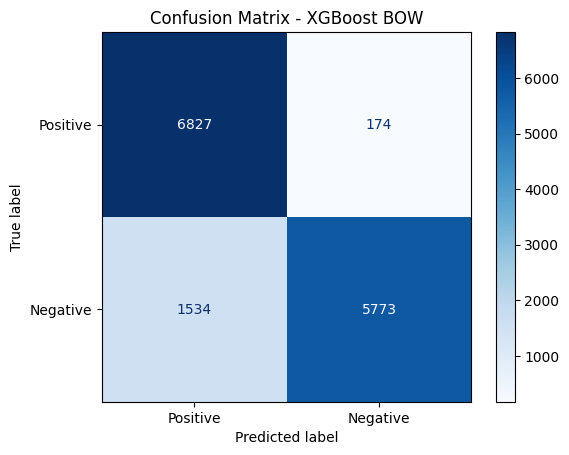

XGBoost TF-IDF Classification Report:
[[6659  342]
 [ 157 7150]] 

              precision    recall  f1-score   support

    Positive       0.98      0.95      0.96      7001
    Negative       0.95      0.98      0.97      7307

    accuracy                           0.97     14308
   macro avg       0.97      0.96      0.97     14308
weighted avg       0.97      0.97      0.97     14308



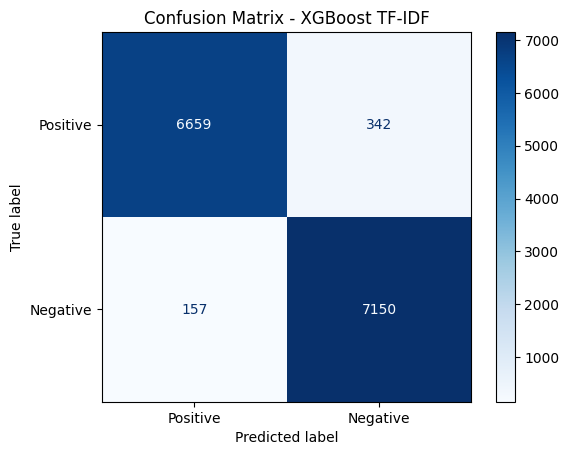

ROC AUC score for XGBoost with TF-IDF:  0.9648317948361674


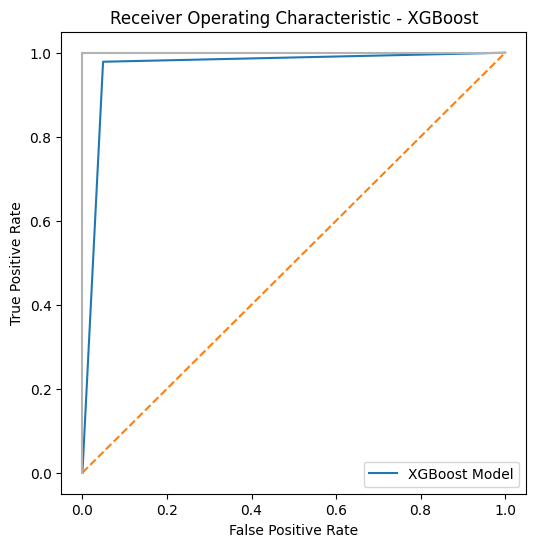

In [ ]:
############################################
###           XGBoost Model              ###
############################################

# Import necessary libraries
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, roc_auc_score, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Initialize the XGBoost classifier
xgb = XGBClassifier(random_state=0, eval_metric='mlogloss', use_label_encoder=False)

# Fitting the model for Bag of Words
xgb_bow = xgb.fit(cv_train_df, train_label)

# Fitting the model for TF-IDF features
xgb_tfidf = xgb.fit(tv_train_df, train_label)

# Predicting the model for Bag of Words
xgb_bow_predict = xgb.predict(cv_test_df)

# Predicting the model for TF-IDF features
xgb_tfidf_predict = xgb.predict(tv_test_df)

# Accuracy score for Bag of Words
xgb_bow_score = accuracy_score(test_label, xgb_bow_predict)
print("XGBoost BOW accuracy :", xgb_bow_score)

# Accuracy score for TF-IDF features
xgb_tfidf_score = accuracy_score(test_label, xgb_tfidf_predict)
print("XGBoost TF-IDF accuracy :", xgb_tfidf_score)

# Classification report for Bag of Words
xgb_bow_report = classification_report(test_label, xgb_bow_predict, target_names=['Positive', 'Negative'])
print("XGBoost BOW Classification Report:")
print(confusion_matrix(test_label, xgb_bow_predict), '\n')
print(xgb_bow_report)

# Plotting confusion matrix for Bag of Words
cm_bow = confusion_matrix(test_label, xgb_bow_predict)
disp_bow = ConfusionMatrixDisplay(confusion_matrix=cm_bow, display_labels=['Positive', 'Negative'])
disp_bow.plot(cmap='Blues')
plt.title('Confusion Matrix - XGBoost BOW')
plt.show()

# Classification report for TF-IDF features
xgb_tfidf_report = classification_report(test_label, xgb_tfidf_predict, target_names=['Positive', 'Negative'])
print("XGBoost TF-IDF Classification Report:")
print(confusion_matrix(test_label, xgb_tfidf_predict), '\n')
print(xgb_tfidf_report)

# Plotting confusion matrix for TF-IDF
cm_tfidf = confusion_matrix(test_label, xgb_tfidf_predict)
disp_tfidf = ConfusionMatrixDisplay(confusion_matrix=cm_tfidf, display_labels=['Positive', 'Negative'])
disp_tfidf.plot(cmap='Blues')
plt.title('Confusion Matrix - XGBoost TF-IDF')
plt.show()

# AUC score and ROC curve for XGBoost with TF-IDF features
FP, TP, threshold1 = roc_curve(test_label, xgb_tfidf_predict)
print('ROC AUC score for XGBoost with TF-IDF: ', roc_auc_score(test_label, xgb_tfidf_predict))

# Plotting the ROC curve
plt.subplots(1, figsize=(6,6))
plt.title('Receiver Operating Characteristic - XGBoost')
plt.plot(FP, TP, label="XGBoost Model")
plt.plot([0, 1], ls="--")
plt.plot([0, 0], [1, 0], c=".7")
plt.plot([1, 1], c=".7")
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc="lower right")
plt.show()


Random Forest BOW accuracy : 0.8205898797875314
Random Forest TF-IDF accuracy : 0.8307939614201845
Random Forest BOW Classification Report:
[[4937 2064]
 [ 503 6804]] 

              precision    recall  f1-score   support

    Positive       0.91      0.71      0.79      7001
    Negative       0.77      0.93      0.84      7307

    accuracy                           0.82     14308
   macro avg       0.84      0.82      0.82     14308
weighted avg       0.84      0.82      0.82     14308



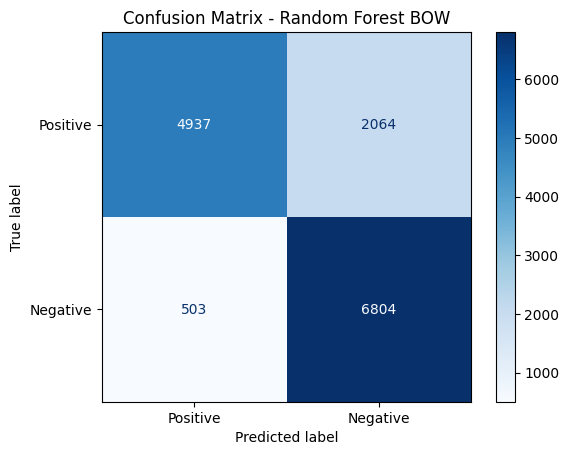

Random Forest TF-IDF Classification Report:
[[5214 1787]
 [ 634 6673]] 

              precision    recall  f1-score   support

    Positive       0.89      0.74      0.81      7001
    Negative       0.79      0.91      0.85      7307

    accuracy                           0.83     14308
   macro avg       0.84      0.83      0.83     14308
weighted avg       0.84      0.83      0.83     14308



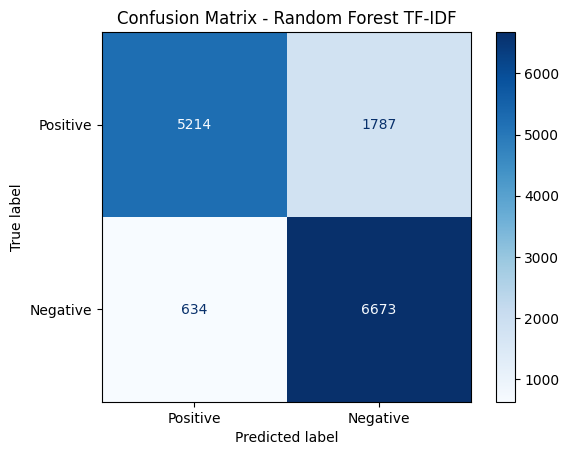

In [ ]:
############################################
###       Random Forest Classifier       ###
############################################

# Import necessary libraries
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Initialize the Random Forest classifier
rf = RandomForestClassifier(random_state=42, n_estimators=100, max_depth=10)

# Fitting the model for Bag of Words
rf_bow = rf.fit(cv_train_df, train_label)

# Fitting the model for TF-IDF features
rf_tfidf = rf.fit(tv_train_df, train_label)

# Predicting the model for Bag of Words
rf_bow_predict = rf.predict(cv_test_df)

# Predicting the model for TF-IDF features
rf_tfidf_predict = rf.predict(tv_test_df)

# Accuracy score for Bag of Words
rf_bow_score = accuracy_score(test_label, rf_bow_predict)
print("Random Forest BOW accuracy :", rf_bow_score)

# Accuracy score for TF-IDF features
rf_tfidf_score = accuracy_score(test_label, rf_tfidf_predict)
print("Random Forest TF-IDF accuracy :", rf_tfidf_score)

# Classification report for Bag of Words
rf_bow_report = classification_report(test_label, rf_bow_predict, target_names=['Positive', 'Negative'])
print("Random Forest BOW Classification Report:")
print(confusion_matrix(test_label, rf_bow_predict), '\n')
print(rf_bow_report)

# Plotting confusion matrix for Bag of Words
cm_bow = confusion_matrix(test_label, rf_bow_predict)
disp_bow = ConfusionMatrixDisplay(confusion_matrix=cm_bow, display_labels=['Positive', 'Negative'])
disp_bow.plot(cmap='Blues')
plt.title('Confusion Matrix - Random Forest BOW')
plt.show()

# Classification report for TF-IDF features
rf_tfidf_report = classification_report(test_label, rf_tfidf_predict, target_names=['Positive', 'Negative'])
print("Random Forest TF-IDF Classification Report:")
print(confusion_matrix(test_label, rf_tfidf_predict), '\n')
print(rf_tfidf_report)

# Plotting confusion matrix for TF-IDF
cm_tfidf = confusion_matrix(test_label, rf_tfidf_predict)
disp_tfidf = ConfusionMatrixDisplay(confusion_matrix=cm_tfidf, display_labels=['Positive', 'Negative'])
disp_tfidf.plot(cmap='Blues')
plt.title('Confusion Matrix - Random Forest TF-IDF')
plt.show()


Decision Tree BOW accuracy : 0.815068493150685
Decision Tree TF-IDF accuracy : 0.9289208834218619
Decision Tree BOW Classification Report:
[[6175  826]
 [1820 5487]] 

              precision    recall  f1-score   support

    Positive       0.77      0.88      0.82      7001
    Negative       0.87      0.75      0.81      7307

    accuracy                           0.82     14308
   macro avg       0.82      0.82      0.81     14308
weighted avg       0.82      0.82      0.81     14308



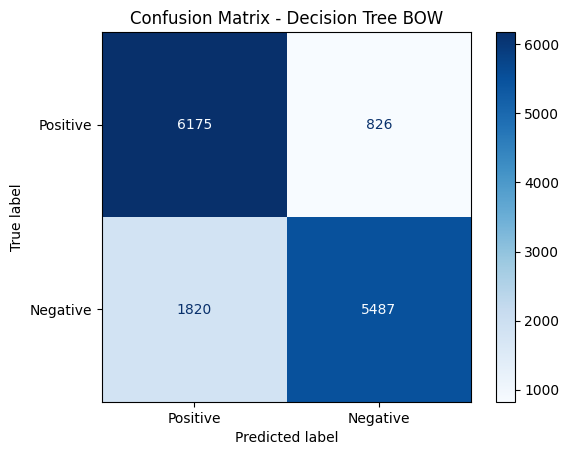

Decision Tree TF-IDF Classification Report:
[[6434  567]
 [ 450 6857]] 

              precision    recall  f1-score   support

    Positive       0.93      0.92      0.93      7001
    Negative       0.92      0.94      0.93      7307

    accuracy                           0.93     14308
   macro avg       0.93      0.93      0.93     14308
weighted avg       0.93      0.93      0.93     14308



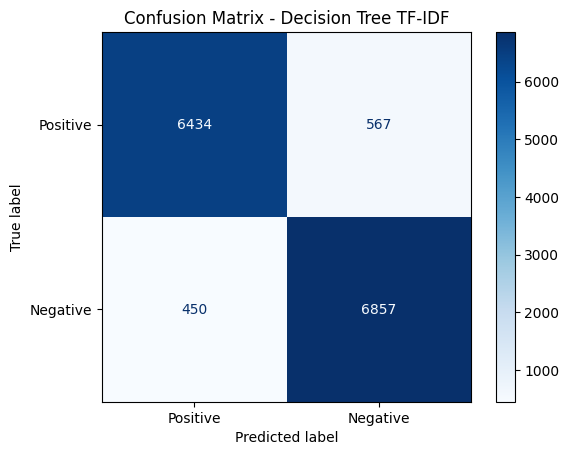

In [ ]:
############################################
###         Decision Tree Classifier     ###
############################################

# Import necessary libraries
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Initialize the Decision Tree classifier
DT = DecisionTreeClassifier(criterion='entropy', random_state=42)

# Fitting the model for Bag of Words
DT_bow = DT.fit(cv_train_df, train_label)

# Fitting the model for TF-IDF features
DT_tfidf = DT.fit(tv_train_df, train_label)

# Predicting the model for Bag of Words
DT_bow_predict = DT.predict(cv_test_df)

# Predicting the model for TF-IDF features
DT_tfidf_predict = DT.predict(tv_test_df)

# Accuracy score for Bag of Words
DT_bow_score = accuracy_score(test_label, DT_bow_predict)
print("Decision Tree BOW accuracy :", DT_bow_score)

# Accuracy score for TF-IDF features
DT_tfidf_score = accuracy_score(test_label, DT_tfidf_predict)
print("Decision Tree TF-IDF accuracy :", DT_tfidf_score)

# Classification report for Bag of Words
DT_bow_report = classification_report(test_label, DT_bow_predict, target_names=['Positive', 'Negative'])
print("Decision Tree BOW Classification Report:")
print(confusion_matrix(test_label, DT_bow_predict), '\n')
print(DT_bow_report)

# Plotting confusion matrix for Bag of Words
cm_bow = confusion_matrix(test_label, DT_bow_predict)
disp_bow = ConfusionMatrixDisplay(confusion_matrix=cm_bow, display_labels=['Positive', 'Negative'])
disp_bow.plot(cmap='Blues')
plt.title('Confusion Matrix - Decision Tree BOW')
plt.show()

# Classification report for TF-IDF features
DT_tfidf_report = classification_report(test_label, DT_tfidf_predict, target_names=['Positive', 'Negative'])
print("Decision Tree TF-IDF Classification Report:")
print(confusion_matrix(test_label, DT_tfidf_predict), '\n')
print(DT_tfidf_report)

# Plotting confusion matrix for TF-IDF
cm_tfidf = confusion_matrix(test_label, DT_tfidf_predict)
disp_tfidf = ConfusionMatrixDisplay(confusion_matrix=cm_tfidf, display_labels=['Positive', 'Negative'])
disp_tfidf.plot(cmap='Blues')
plt.title('Confusion Matrix - Decision Tree TF-IDF')
plt.show()


Naive Bayes BOW accuracy : 0.8599384959463238
Naive Bayes TF-IDF accuracy : 0.8779004752585966
Naive Bayes BOW Classification Report:
[[6542  459]
 [1545 5762]] 

              precision    recall  f1-score   support

    Positive       0.81      0.93      0.87      7001
    Negative       0.93      0.79      0.85      7307

    accuracy                           0.86     14308
   macro avg       0.87      0.86      0.86     14308
weighted avg       0.87      0.86      0.86     14308



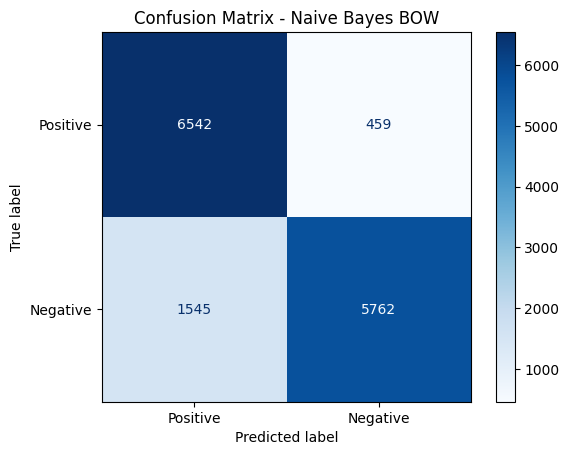

Naive Bayes TF-IDF Classification Report:
[[6399  602]
 [1145 6162]] 

              precision    recall  f1-score   support

    Positive       0.85      0.91      0.88      7001
    Negative       0.91      0.84      0.88      7307

    accuracy                           0.88     14308
   macro avg       0.88      0.88      0.88     14308
weighted avg       0.88      0.88      0.88     14308



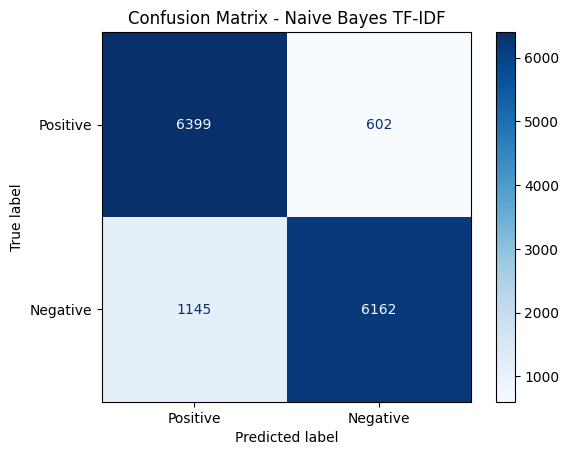

ROC AUC score for Naive Bayes:  0.8786566141297103


In [ ]:
############################################
###       Naive Bayes Classifier         ###
############################################

# Import necessary libraries
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, roc_auc_score, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Initialize the Naive Bayes classifier
nb = MultinomialNB()

# Fitting the model for Bag of Words
nb_bow = nb.fit(cv_train_df, train_label)

# Fitting the model for TF-IDF features
nb_tfidf = nb.fit(tv_train_df, train_label)

# Predicting the model for Bag of Words
nb_bow_predict = nb.predict(cv_test_df)

# Predicting the model for TF-IDF features
nb_tfidf_predict = nb.predict(tv_test_df)

# Accuracy score for Bag of Words
nb_bow_score = accuracy_score(test_label, nb_bow_predict)
print("Naive Bayes BOW accuracy :", nb_bow_score)

# Accuracy score for TF-IDF features
nb_tfidf_score = accuracy_score(test_label, nb_tfidf_predict)
print("Naive Bayes TF-IDF accuracy :", nb_tfidf_score)

# Classification report for Bag of Words
nb_bow_report = classification_report(test_label, nb_bow_predict, target_names=['Positive', 'Negative'])
print("Naive Bayes BOW Classification Report:")
print(confusion_matrix(test_label, nb_bow_predict), '\n')
print(nb_bow_report)

# Plotting confusion matrix for Bag of Words
cm_bow = confusion_matrix(test_label, nb_bow_predict)
disp_bow = ConfusionMatrixDisplay(confusion_matrix=cm_bow, display_labels=['Positive', 'Negative'])
disp_bow.plot(cmap='Blues')
plt.title('Confusion Matrix - Naive Bayes BOW')
plt.show()

# Classification report for TF-IDF features
nb_tfidf_report = classification_report(test_label, nb_tfidf_predict, target_names=['Positive', 'Negative'])
print("Naive Bayes TF-IDF Classification Report:")
print(confusion_matrix(test_label, nb_tfidf_predict), '\n')
print(nb_tfidf_report)

# Plotting confusion matrix for TF-IDF
cm_tfidf = confusion_matrix(test_label, nb_tfidf_predict)
disp_tfidf = ConfusionMatrixDisplay(confusion_matrix=cm_tfidf, display_labels=['Positive', 'Negative'])
disp_tfidf.plot(cmap='Blues')
plt.title('Confusion Matrix - Naive Bayes TF-IDF')
plt.show()

# AUC score and ROC curve for Naive Bayes with TF-IDF features
fpr, tpr, thresholds = roc_curve(test_label, nb_tfidf_predict)
roc_auc = roc_auc_score(test_label, nb_tfidf_predict)

print('ROC AUC score for Naive Bayes: ', roc_auc)


In [ ]:
#As we can see, XGBoost performs better than all the other models, followed by


Prediction Models & Intepretability Model(LIME)

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 7.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=febc8c01e525d9229256cc9cdcccfcd404d0c3b950a01c3384b0572e82705ae5
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


In [ ]:
import ipywidgets as widgets
from IPython.display import display
from xgboost import XGBClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from lime.lime_text import LimeTextExplainer
import pandas as pd
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import cross_val_score, train_test_split # Import for cross-validation and data splitting

############################################
###            XGBoost Model             ###
############################################

############################################
###   1. Define Prediction Output Message ###
############################################
def predict_text(label):
    if label == 0:
        return "🛑 It is a fake news, sorry!!!"
    elif label == 1:
        return "✅ Definitely credible, it is not a fake news."
    else:
        return "⚠️ Invalid label: must be 0 or 1."

############################################
###   2. Define Text Prediction Pipeline  ###
############################################
def predict_news_input(user_input, model, vectorizer):
    # Transform the text using the trained TF-IDF vectorizer
    # Use transform instead of fit_transform to avoid creating new vocabulary
    transformed_input = vectorizer.transform([user_input])

    # Make prediction using trained XGBoost model
    prediction = model.predict(transformed_input)[0]

    # Return readable output
    return predict_text(prediction)

############################################
###   3. Load or Assume Existing Models   ###
############################################
# Assuming dfp1 is your original DataFrame
dfp1 = get_ipython().user_ns.get('dfp1')

# Split the data into training and testing sets (80% train, 20% test)
train_df, test_df, train_label, test_label = train_test_split(
    dfp1.text, dfp1.label, test_size=0.2, random_state=42
)

# TF-IDF Vectorizer
tv = TfidfVectorizer()
tv_train_df = tv.fit_transform(train_df)
tv_test_df = tv.transform(test_df)

# XGBoost Model
xgb_tfidf = XGBClassifier(random_state=0, eval_metric='mlogloss', use_label_encoder=False)

############################################
###   4. Perform Cross-Validation        ###
############################################
# Perform cross-validation (e.g., 5-fold)
cv_scores = cross_val_score(xgb_tfidf, tv_train_df, train_label, cv=5)

# Print cross-validation results
print("Cross-Validation Scores:", cv_scores)
print("Average Accuracy:", cv_scores.mean())

# Fit the model after cross-validation
xgb_tfidf.fit(tv_train_df, train_label)

# Step 5: LIME for Interpretability
# Create a LIME explainer for the trained model
explainer = LimeTextExplainer(class_names=['Fake', 'Real'])

# Define the prediction function for LIME
def predict_fn(texts):
    return xgb_tfidf.predict_proba(tv.transform(texts)) # Use transform here as well

# Step 6: Explain the prediction
def explain_prediction(user_input):
    # Use LIME to explain the prediction
    explanation = explainer.explain_instance(user_input, predict_fn, num_features=10)  # Top 10 features
    explanation.show_in_notebook(text=True)  # Show explanation in Jupyter notebook (interactive)
    return explanation

############################################
###   7. Interactive Prediction Input    ###
############################################
# Create a TextBox widget for input
text_box = widgets.Text(
    value='',
    placeholder='Type your news text here...',
    description='News Text:',
    disabled=False
)

# Create a button for triggering prediction
predict_button = widgets.Button(description="Predict")

# Define what happens when the button is clicked
def on_button_clicked(b):
    user_input = text_box.value
    # Get prediction result using your trained model
    result_message = predict_news_input(user_input, model=xgb_tfidf, vectorizer=tv)
    print("\n📢 Prediction Result:")
    print(result_message)

    # Get and visualize LIME explanation
    print("\n🔍 LIME Explanation:")
    explain_prediction(user_input)

# Link the button click to the prediction function
predict_button.on_click(on_button_clicked)

# Display the text box and the button
display(text_box, predict_button)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [18:08:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [18:12:51] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [18:17:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [18:21:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [18:25:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_e

Cross-Validation Scores: [0.96007339 0.96330596 0.95850079 0.96199546 0.96164264]
Average Accuracy: 0.9611036456865054


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [18:29:30] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Text(value='', description='News Text:', placeholder='Type your news text here...')

Button(description='Predict', style=ButtonStyle())


📢 Prediction Result:
✅ Definitely credible, it is not a fake news.

🔍 LIME Explanation:



📢 Prediction Result:
🛑 It is a fake news, sorry!!!

🔍 LIME Explanation:



📢 Prediction Result:
✅ Definitely credible, it is not a fake news.

🔍 LIME Explanation:



📢 Prediction Result:
🛑 It is a fake news, sorry!!!

🔍 LIME Explanation:


ValueError: Feature shape mismatch, expected: 271994, got 309779

In [ ]:
import ipywidgets as widgets
from IPython.display import display
from sklearn.tree import DecisionTreeClassifier  # Import Decision Tree model
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from lime.lime_text import LimeTextExplainer
import pandas as pd
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import cross_val_score  # Import for cross-validation

############################################
###         DECISION TREE MODEL          ###
############################################

############################################
###   1. Define Prediction Output Message ###
############################################
def predict_text(label):
    if label == 0:
        return "🛑 It is a fake news, sorry!!!"
    elif label == 1:
        return "✅ Definitely credible, it is not a fake news."
    else:
        return "⚠️ Invalid label: must be 0 or 1."


############################################
###   2. Define Text Prediction Pipeline  ###
############################################
def predict_news_input(user_input, model, vectorizer):
    # Transform the text using the trained TF-IDF vectorizer
    transformed_input = vectorizer.transform([user_input])

    # Make prediction using trained Decision Tree model
    prediction = model.predict(transformed_input)[0]

    # Return readable output
    return predict_text(prediction)


############################################
###   3. Load or Assume Existing Models   ###
############################################
# Using your actual data
df = get_ipython().user_ns.get('dfp1')  # Retrieve dfp1 from user namespace
train_label = df['label']
train_df = df['text']

# TF-IDF Vectorizer
tv = TfidfVectorizer()
tv_train_df = tv.fit_transform(train_df)

# Decision Tree Model
DT = DecisionTreeClassifier(criterion='entropy', random_state=42)

# Fit the model
DT.fit(tv_train_df, train_label)

############################################
###   4. Perform Cross-Validation        ###
############################################
# Perform cross-validation (e.g., 5-fold)
cv_scores = cross_val_score(DT, tv_train_df, train_label, cv=5)

# Print cross-validation results
print("Cross-Validation Scores:", cv_scores)
print("Average Accuracy:", cv_scores.mean())



# Step 5: LIME for Interpretability
# Create a LIME explainer for the trained model
explainer = LimeTextExplainer(class_names=['Fake', 'Real'])

# Define the prediction function for LIME
def predict_fn(texts):
    return DT.predict_proba(tv.transform(texts))

# Step 6: Explain the prediction
def explain_prediction(user_input):
    # Use LIME to explain the prediction
    explanation = explainer.explain_instance(user_input, predict_fn, num_features=10)  # Top 10 features
    explanation.show_in_notebook(text=True)  # Show explanation in Jupyter notebook (interactive)
    return explanation

############################################
###   7. Interactive Prediction Input    ###
############################################
# Create a TextBox widget for input
text_box = widgets.Text(
    value='',
    placeholder='Type your news text here...',
    description='News Text:',
    disabled=False
)

# Create a button for triggering prediction
predict_button = widgets.Button(description="Predict")

# Define what happens when the button is clicked
def on_button_clicked(b):
    user_input = text_box.value
    # Get prediction result using your trained model
    result_message = predict_news_input(user_input, model=DT, vectorizer=tv)
    print("\n📢 Prediction Result:")
    print(result_message)

    # Get and visualize LIME explanation
    print("\n🔍 LIME Explanation:")
    explain_prediction(user_input)

# Link the button click to the prediction function
predict_button.on_click(on_button_clicked)

# Display the text box and the button
display(text_box, predict_button)

Cross-Validation Scores: [0.92752306 0.92703383 0.92842664 0.92709862 0.92716852]
Average Accuracy: 0.927450135501625


Text(value='', description='News Text:', placeholder='Type your news text here...')

Button(description='Predict', style=ButtonStyle())


📢 Prediction Result:
✅ Definitely credible, it is not a fake news.

🔍 LIME Explanation:



📢 Prediction Result:
✅ Definitely credible, it is not a fake news.

🔍 LIME Explanation:



📢 Prediction Result:
✅ Definitely credible, it is not a fake news.

🔍 LIME Explanation:



📢 Prediction Result:
✅ Definitely credible, it is not a fake news.

🔍 LIME Explanation:



📢 Prediction Result:
🛑 It is a fake news, sorry!!!

🔍 LIME Explanation:



📢 Prediction Result:
✅ Definitely credible, it is not a fake news.

🔍 LIME Explanation:



📢 Prediction Result:
✅ Definitely credible, it is not a fake news.

🔍 LIME Explanation:
